In [2]:
# System libraries:
%load_ext autoreload
import pandas as pd
import json
import nltk
import numpy as np
import os
import sys
from IPython.core.interactiveshell import InteractiveShell
from pymystem3 import Mystem
from nltk.tokenize import word_tokenize
from nltk.corpus import stopwords
import string
from collections import Counter
from wordcloud import WordCloud
import matplotlib.pyplot as plt
from datetime import datetime
import re
import gensim.downloader as api
from gensim.models import TfidfModel
from gensim.corpora import Dictionary
InteractiveShell.ast_node_interactivity = "all"

In [3]:
integrum_federal_lemmas = pd.read_csv('data/processed/integrum_federal_lemmas.csv', converters = {'lemmas_content' : eval, 'lemmas_headline':eval})
integrum_local_lemmas = pd.read_csv('data/processed/integrum_local_lemmas.csv', converters = {'lemmas_content' : eval, 'lemmas_headline':eval})
integrum_local_lemmas.iloc[:5]
integrum_federal_lemmas.iloc[:5]



,year,lemmas_content,lemmas_headline
0,2000,"[начальник, выборгский, таможня, иван, иоч, да...","[таможня, разблокировать]"
1,2000,"[только, замедление, темп, рост, американский,...","[что, плохо]"
2,2000,"[оао, lt, газпром, gt, завершать, длиться, год...","[lt, газпром, gt, протягивать, ветка]"
3,2000,"[во, дворец, спорт, ска, хоккей, играть, на, м...","[бизнесмен, драться, клюшка]"
4,2000,"[на, собрание, акционер, оао, lt, квернер, выб...","[Kvaerner, исчезать, карта, область]"


,year,lemmas_content,lemmas_headline
0,2003,"[о, чешский, тренер, владимир, вуйтек, нынче, ...","[владимир, вуйтек, главный, тренер, хоккейный,..."
1,2003,"[в, минувший, воскресение, исполняться, год, д...","[судьба, маргарита]"
2,2003,"[в, минувший, выходной, греция, завершаться, 1...","[девушка, кокошник, лицо, россия]"
3,2003,"[сотрудник, мид, финляндия, разыскивать, живой...","[не, проходить, полвека]"
4,2003,"[EXXON, MOBIL, намерен, развивать, сотрудничес...",[хроника]


In [4]:
# clear lemmas from special characters:
re_cleanup = re.compile('(^quot$|^lt$|^gt$|^II$|^\/.*|^http.*|^ .*|^www|^-.*|.*[0-9].*|\?|\.|^\&.*|.*-$|^lude$|^lisä$|\\n|^[A-Z]$|\*|\_|\'|\"|\`|nbsp|^.$|mdash|^Ag$|^Co|^Bank|Inc)', re.IGNORECASE)
re_cleanup.match('ltsdffd')
def clean_lemmas(word_list):
    filtered_sentence = [w for w in word_list if not re_cleanup.match(w)]
    return filtered_sentence

In [5]:
cleaned_lemmas_local = integrum_local_lemmas.lemmas_content.apply(clean_lemmas)
cleaned_lemmas_federal = integrum_federal_lemmas.lemmas_content.apply(clean_lemmas)



In [51]:
cleaned_lemmas_local

0        [начальник, выборгский, таможня, иван, иоч, да...
1        [только, замедление, темп, рост, американский,...
2        [оао, газпром, завершать, длиться, год, строит...
3        [во, дворец, спорт, ска, хоккей, играть, на, м...
4        [на, собрание, акционер, оао, квернер, выборг,...
5        [на, шляпный, фронт, зреть, перемена, один, са...
6        [зао, шестнадцатый, трест, завершать, реконстр...
7        [задержание, глава, группа, медиа, владимир, г...
8        [вчера, санкт-петербургский, ассоциация, содей...
9        [конец, июнь, начинать, действовать, паромный,...
10       [дмитрий, мотылек, сыктывкар, коми, начинаться...
11       [губернатор, ленинградский, область, валерий, ...
12       [вадим, бараус, финляндский, телекоммуникацион...
13       [уже, год, маленький, финский, город, лаппенра...
14       [вчера, июнь, выбор, председатель, правление, ...
15       [государственный, таможенный, комитет, готовит...
16       [гуп, водоканал, санкт-петербург, форсировать,.

In [6]:
integrum_local_lemmas.lemmas_content = cleaned_lemmas_local
integrum_federal_lemmas.lemmas_content = cleaned_lemmas_federal

In [12]:
def get_corpus_tfidf(documents):
    dictionary = Dictionary(documents)
    n_items = len(dictionary)
    corpus = [dictionary.doc2bow(text) for text in documents]
    tfidf = TfidfModel(corpus)
    return tfidf[corpus], dictionary


def get_tf_idf_counts(series):
    tf_idf_flattened = [b for a in series for b in a if not type(a) == float]
    counts = Counter(tf_idf_flattened)
    return counts

def yearly_counts(word_list):
    counts = Counter(word_list)
    return counts



def get_top_words(corpus_tfidf, dictionary):
    top_words_series = pd.Series(index=range(0,len(corpus_tfidf)))
    top_words_series.name = 'tf_idf_words'
    for i, row in enumerate(corpus_tfidf):
        # sort the list
        sorted_by_second = sorted(row, key=lambda tup: tup[1])
        # get the top 20 elements
        a = np.array(sorted_by_second[-20:], dtype=np.int32)
        # get the first indices
        idx = a[:,0].tolist()
        #dictionary[a[:,0].tolist()]
        article_top_words = [dictionary[i] for i in idx]
        top_words_series.iloc[i] = article_top_words
        
    return top_words_series


def output_wordcloud(counts, title = None, save_image = False, path = 'generated_images/'):
    cloud = WordCloud(stopwords=None, background_color='white', width=2400, height=1800
                     ).generate_from_frequencies(counts)

    plt.figure(figsize=(30,18))
    if title:
        plt.title(title, fontsize=90)
    plt.imshow(cloud)
    plt.axis('off')
    if save_image and title:
        plt.savefig(path + title + ".png")
    plt.show()

def print_yearly_wordclouds(tfidf_data, prefix):
    for year in sorted(tfidf_data.year.unique()):
        yearly_data = tfidf_data[tfidf_data['year'] == year].tf_idf_words
        counts = get_tf_idf_counts(yearly_data)
        title = prefix + str(year)
        output_wordcloud(counts, title, True)

In [30]:
documents = integrum_local_lemmas.lemmas_content
dictionary = Dictionary(documents)
n_items = len(dictionary)
corpus = [dictionary.doc2bow(text) for text in documents]
tfidf = models.TfidfModel(corpus)
corpus_tfidf = tfidf[corpus]

In [57]:
integrum_local_tfidf, integrum_local_dictionary = get_corpus_tfidf(integrum_local_lemmas.lemmas_content)
integrum_federal_tfidf, integrum_federal_dictionary = get_corpus_tfidf(integrum_federal_lemmas.lemmas_content)


top_words_local = get_top_words(integrum_local_tfidf, integrum_local_dictionary)
top_words_federal = get_top_words(integrum_federal_tfidf, integrum_federal_dictionary)



In [37]:
corpus_tfidf = integrum_federal_tfidf
dictionary = integrum_federal_dictionary
top_words_series = pd.Series(index=range(0,len(corpus_tfidf)))
top_words_series.name = 'tf_idf_words'
for i, row in enumerate(corpus_tfidf):
    # sort the list
    sorted_by_second = sorted(row, key=lambda tup: tup[1])
    # get the top 20 elements
    a = np.array(sorted_by_second[-20:], dtype=np.int32)
    # get the first indices
    if len(a):
        idx = a[:,0].tolist()
        article_top_words = [dictionary[i] for i in idx]
        top_words_series.iloc[i] = article_top_words
    else:
        top_words_series.iloc[i] = []

top_words_series

0        [дескать, никогда, ваш, казань, чербаев, иван,...
1        [гранка, познакомиться, масленица, писатель, с...
2        [самойленков, федоскинский, регион, байкал, ре...
3        [пелтокоски, жертва, советский, известие, шпио...
4        [автомобиль, SUBARU, юкоссибнефть, EXXON, MOBI...
5        [выматывать, неподражаемый, необычный, фанатка...
6        [обструкция, календарь, кубок, зинэтулла, макс...
7        [вексель, семен, ING, нефтяной, ДВМП, кисломол...
8        [состав, препарат, НКММ, снег, магний, мади, п...
9        [шайба, раямяка, вратарь, люндквист, четырехэт...
10       [перистерь, рикельме, олимпиакос, положение, п...
11       [профиль, KISSов, железячник, киссов, кошмарик...
12       [забивать, кардифф, мостовой, хьюз, ворота, ва...
13       [видоискатель, установленный, компьютер, би-би...
14       [петербургский, часовня, слушание, окно, произ...
15       [памес, перистерь, телиндус, турк, арвидас, ас...
16       [страна, реактор, консульство, повлиять, рейс,.

In [39]:
len(top_words_series)
len(integrum_federal_tfidf)

25374

25374

In [58]:
top_words_local = get_top_words(integrum_local_tfidf, integrum_local_dictionary)

In [59]:
top_words_federal = get_top_words(integrum_federal_tfidf, integrum_federal_dictionary)

In [60]:
# combine year with tf_idf stuff

integrum_local_lemmas.iloc[:5]

integrum_local_tfidf_words = pd.concat([integrum_local_lemmas['year'], top_words_local], axis = 1)

integrum_local_tfidf_words.iloc[:5]

,year,lemmas_content,lemmas_headline
0,2000,"[начальник, выборгский, таможня, иван, иоч, да...","[таможня, разблокировать]"
1,2000,"[только, замедление, темп, рост, американский,...","[что, плохо]"
2,2000,"[оао, газпром, завершать, длиться, год, строит...","[lt, газпром, gt, протягивать, ветка]"
3,2000,"[во, дворец, спорт, ска, хоккей, играть, на, м...","[бизнесмен, драться, клюшка]"
4,2000,"[на, собрание, акционер, оао, квернер, выборг,...","[Kvaerner, исчезать, карта, область]"


,year,tf_idf_words
0,2000,"[граница, очередь, приостанавливать, осмотр, у..."
1,2000,"[котировка, технологичный, замедление, Sonera,..."
2,2000,"[функция, соединять, магистраль, освоение, ава..."
3,2000,"[дружно, табло, банкет, павел, турнир, соперни..."
4,2000,"[выборг, Launch, оправлять, переименовывать, б..."


In [61]:
# combine year with tf_idf stuff

integrum_federal_lemmas.iloc[:5]

integrum_federal_tfidf_words = pd.concat([integrum_federal_lemmas['year'], top_words_federal], axis = 1)

integrum_federal_tfidf_words.iloc[:5]




,year,lemmas_content,lemmas_headline
0,2003,"[чешский, тренер, владимир, вуйтек, нынче, при...","[владимир, вуйтек, главный, тренер, хоккейный,..."
1,2003,"[минувший, воскресение, исполняться, год, день...","[судьба, маргарита]"
2,2003,"[минувший, выходной, греция, завершаться, межд...","[девушка, кокошник, лицо, россия]"
3,2003,"[сотрудник, мид, финляндия, разыскивать, живой...","[не, проходить, полвека]"
4,2003,"[EXXON, MOBIL, намерен, развивать, сотрудничес...",[хроника]


,year,tf_idf_words
0,2003,"[дескать, никогда, ваш, казань, чербаев, иван,..."
1,2003,"[гранка, познакомиться, масленица, писатель, с..."
2,2003,"[самойленков, федоскинский, регион, байкал, ре..."
3,2003,"[пелтокоски, жертва, советский, известие, шпио..."
4,2003,"[автомобиль, SUBARU, юкоссибнефть, EXXON, MOBI..."


In [62]:
integrum_federal_tfidf_words.to_csv('data/processed/integrum_federal_tfidf.csv')
integrum_local_tfidf_words.to_csv('data/processed/integrum_local_tfidf.csv')

In [29]:
integrum_local_tfidf

In [116]:
# Target 1 - continued - get a word cloud using TF-IDF for the whole dataset

# Concatenate selected lists in the data['tfidf_top_words'] and generate a histogram




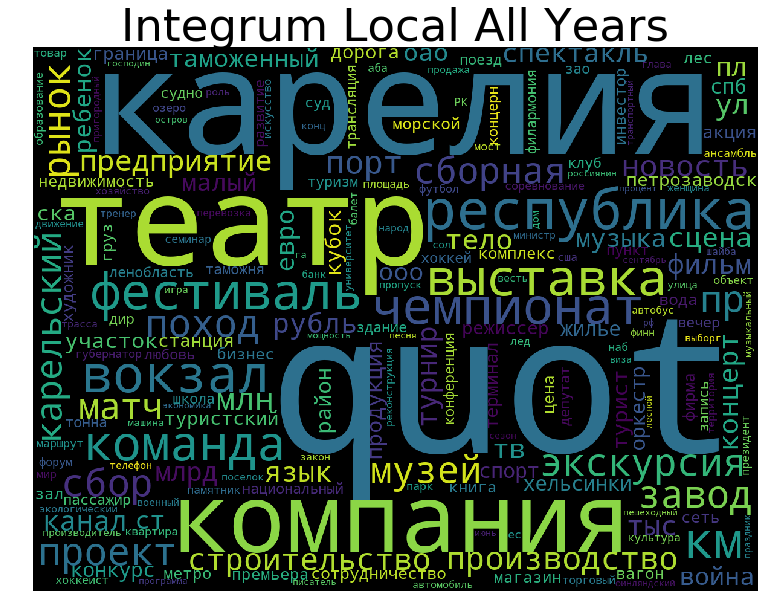

In [47]:
counts = get_tf_idf_counts(top_words_local)  
output_wordcloud(counts, 'Integrum Local All Years')

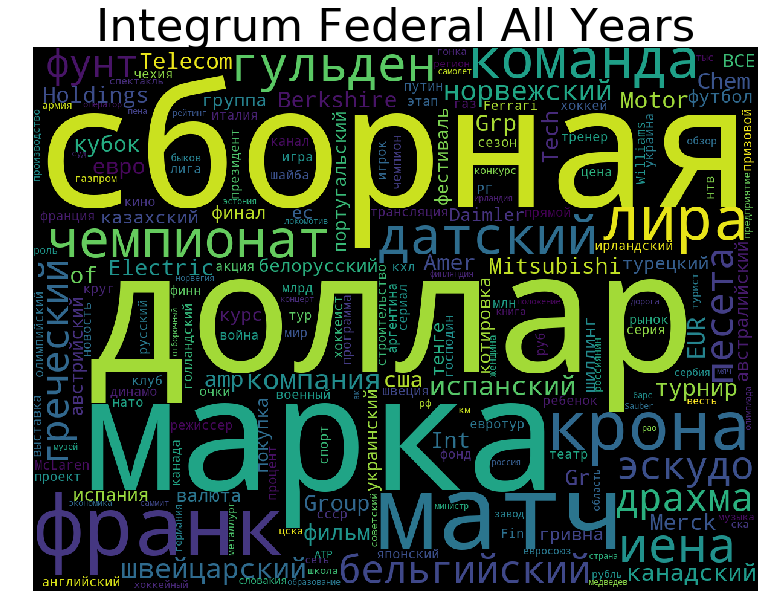

In [48]:
counts = get_tf_idf_counts(top_words_federal)  
output_wordcloud(counts, 'Integrum Federal All Years')

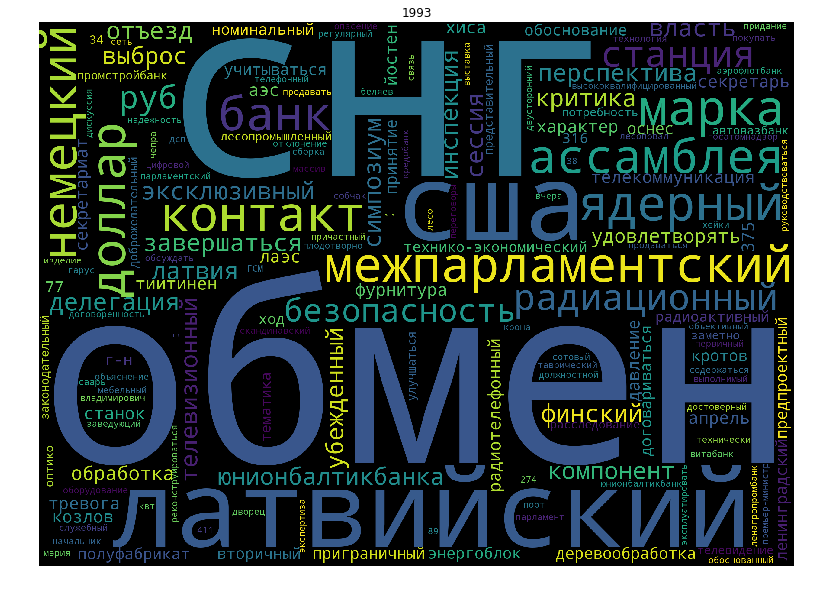

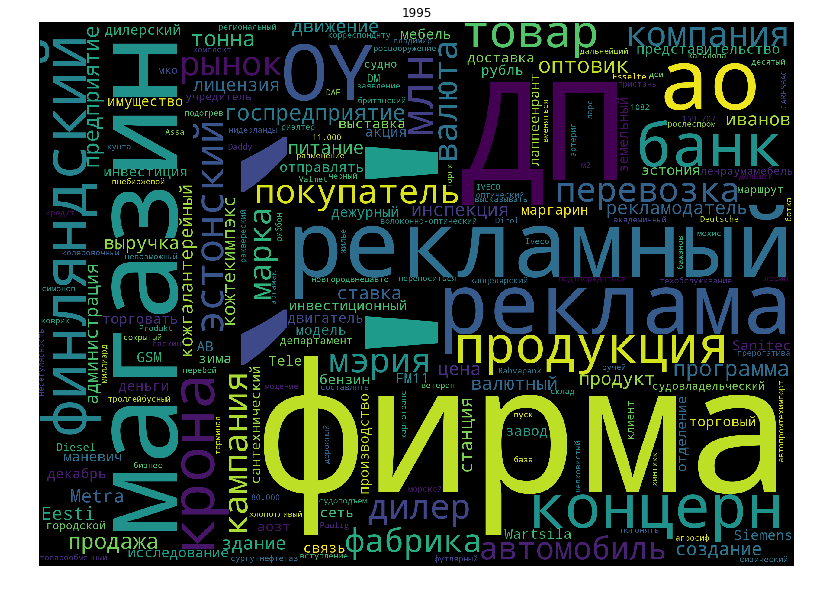

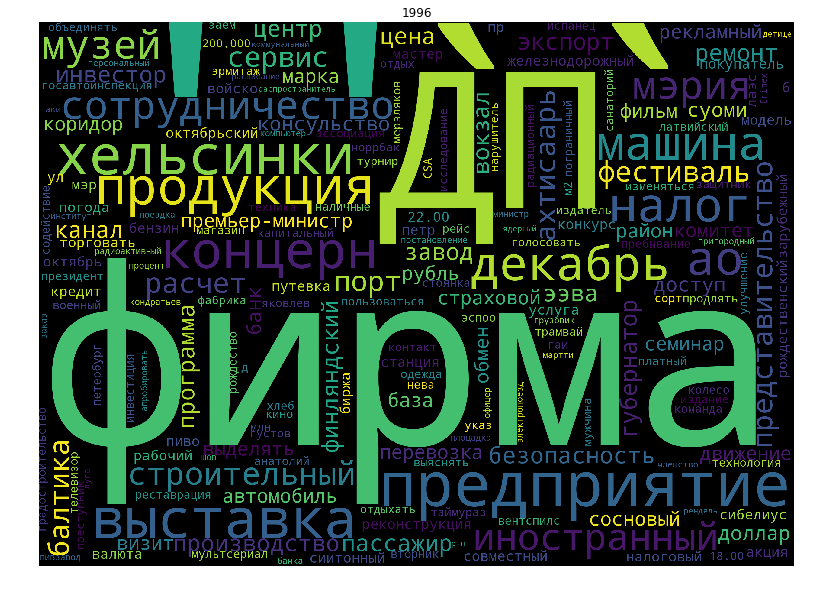

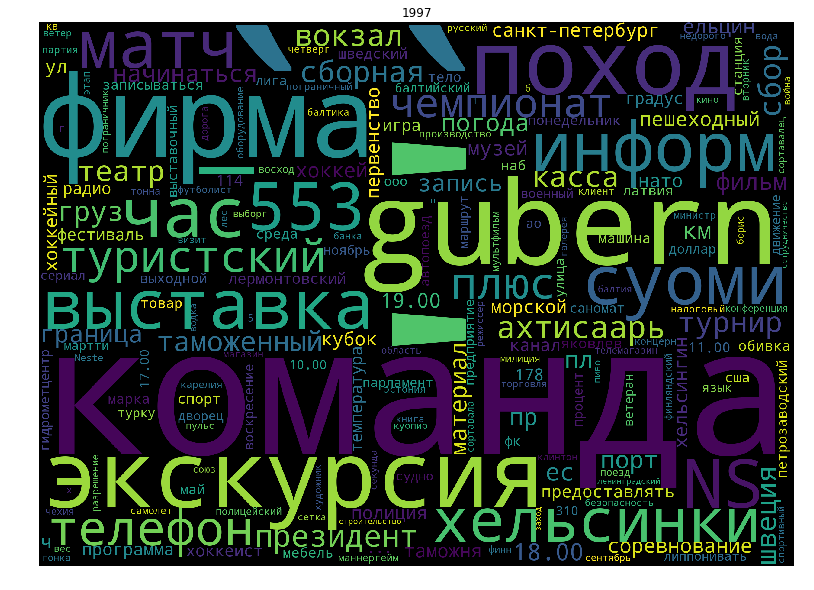

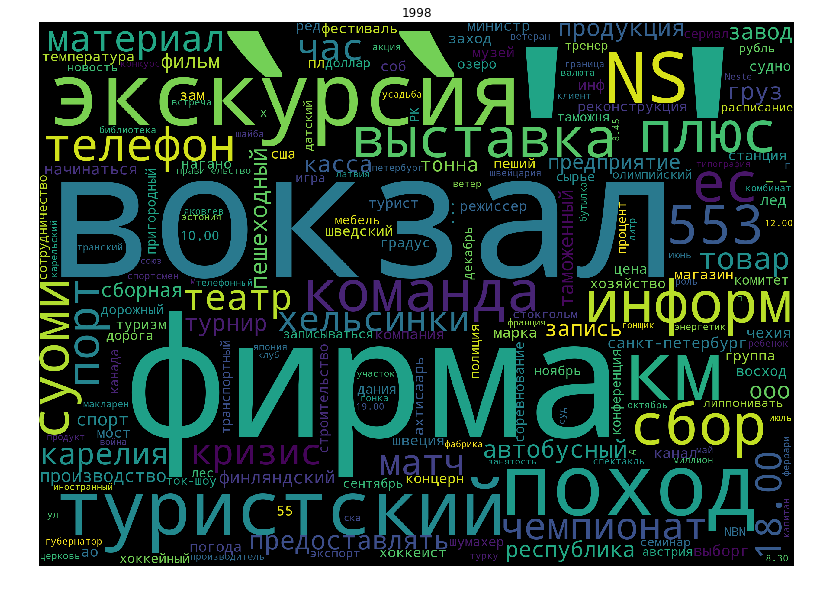

...

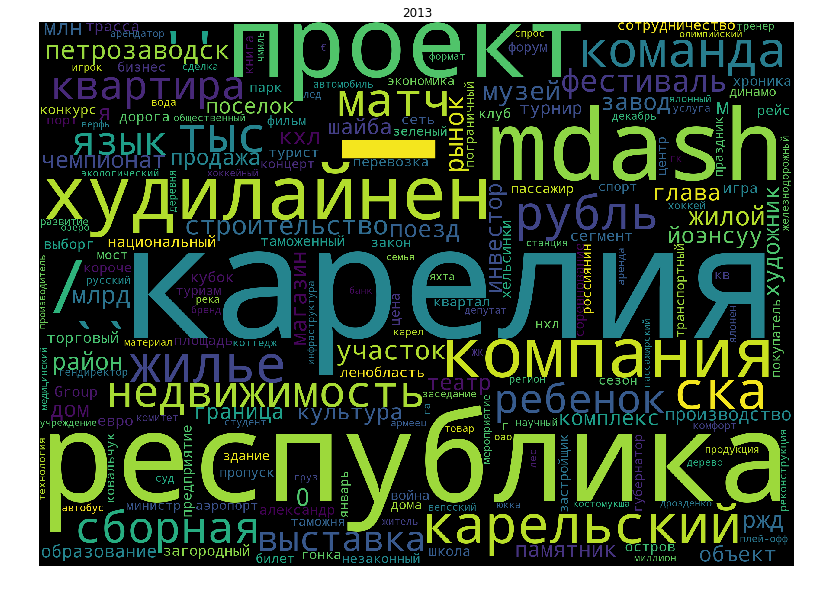

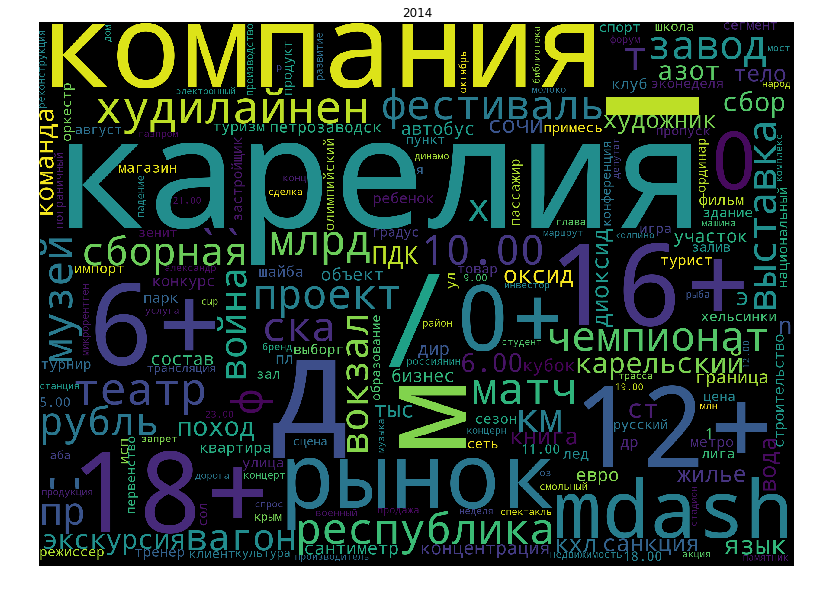

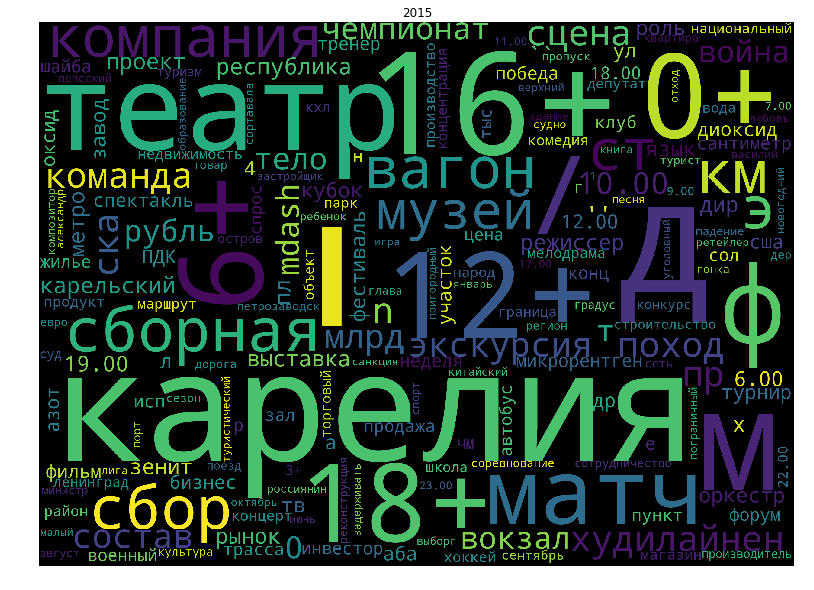

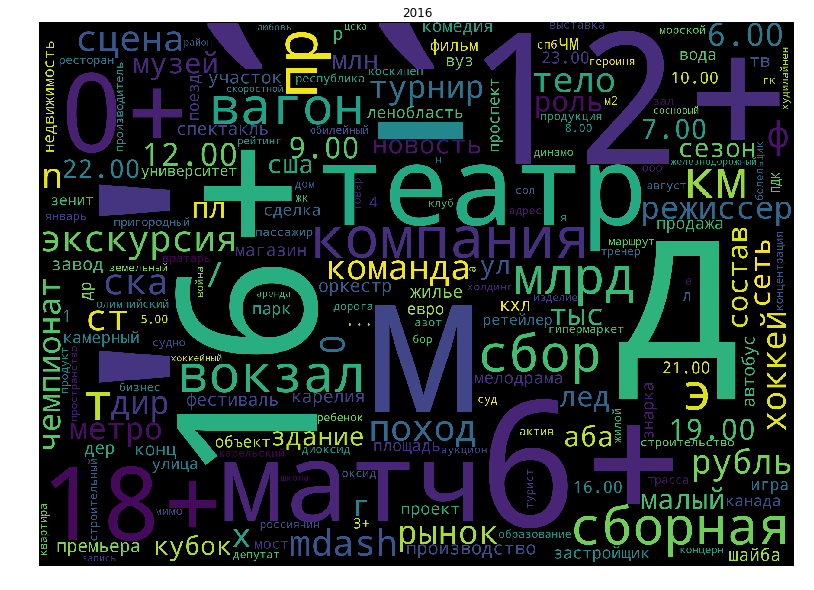

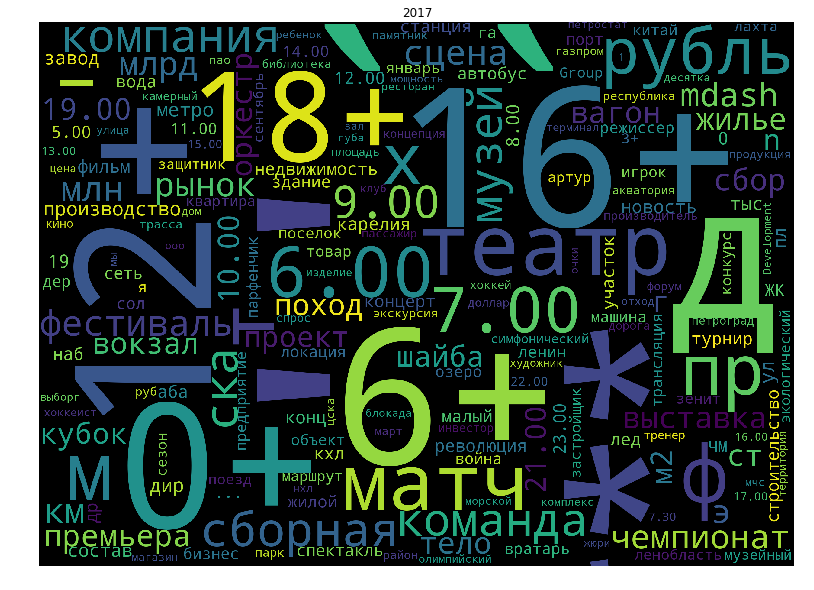

In [93]:
for year in sorted(integrum_local_tfidf.year.unique()):
    yearly_data = integrum_local_tfidf[integrum_local_tfidf['year'] == year].tf_idf_words
    counts = get_tf_idf_counts(yearly_data)  
    output_wordcloud(counts, year)

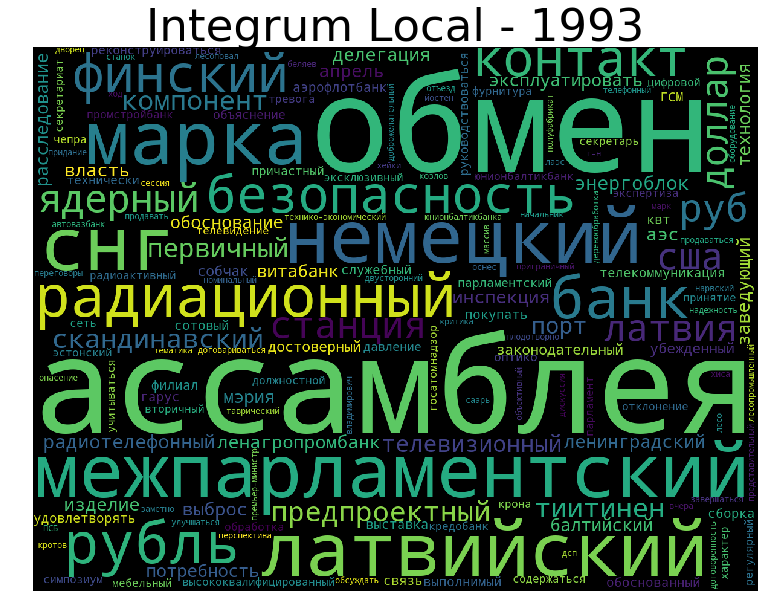

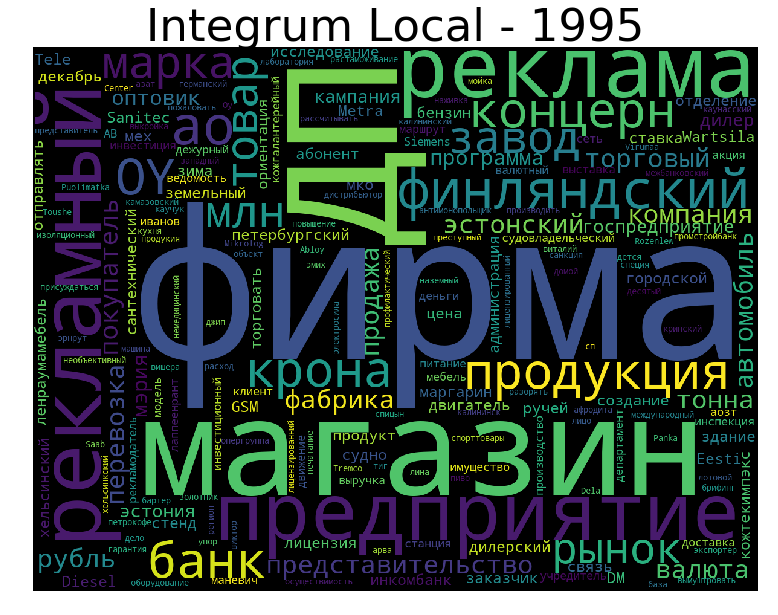

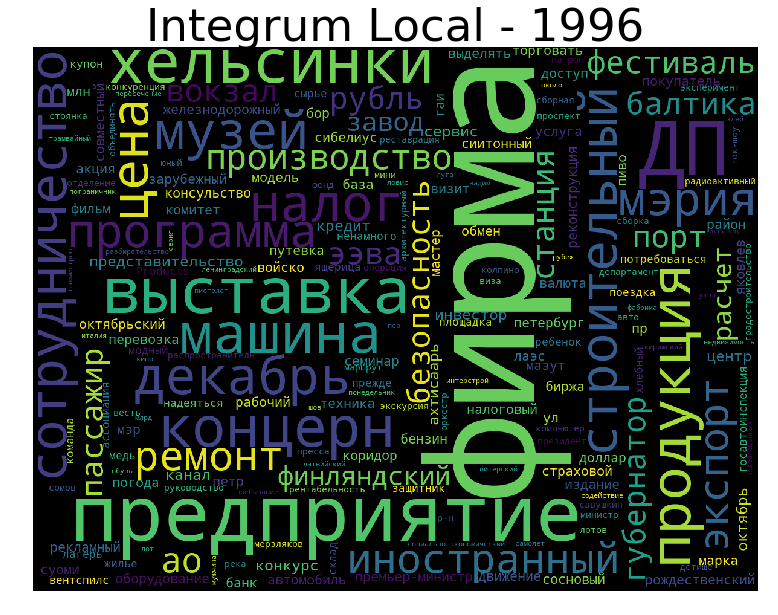

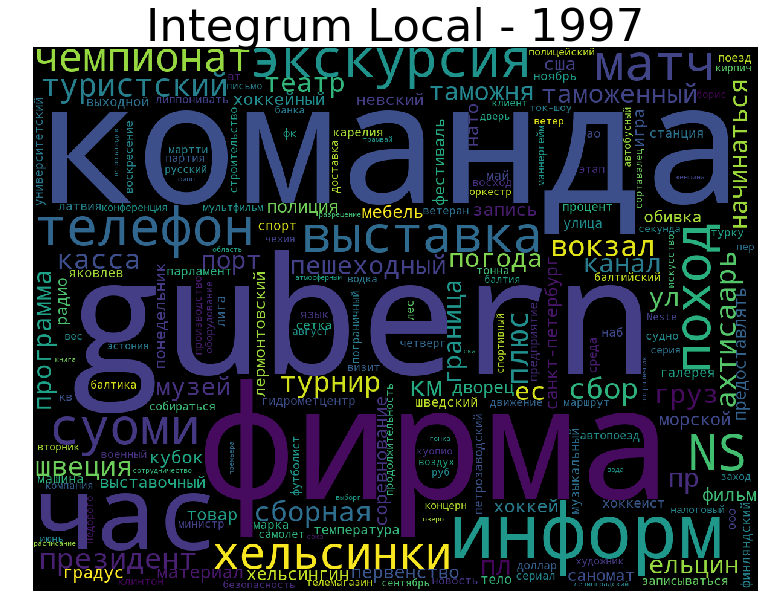

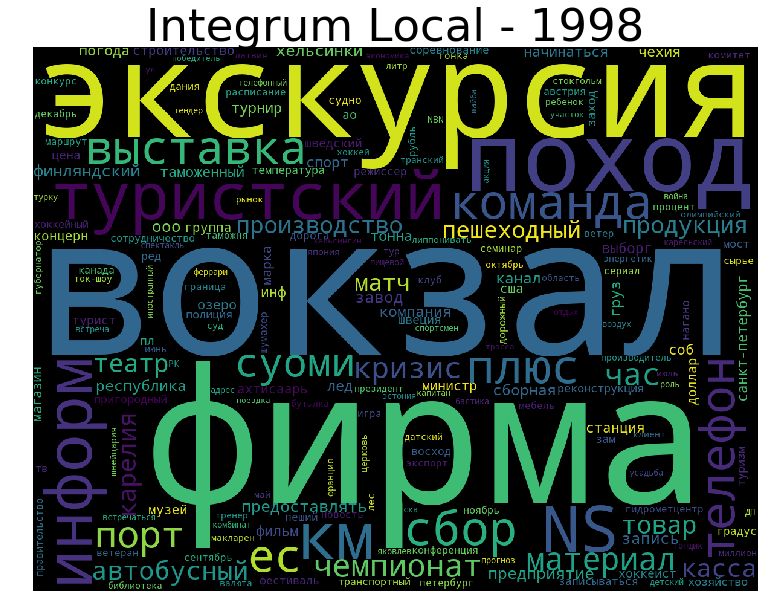

...

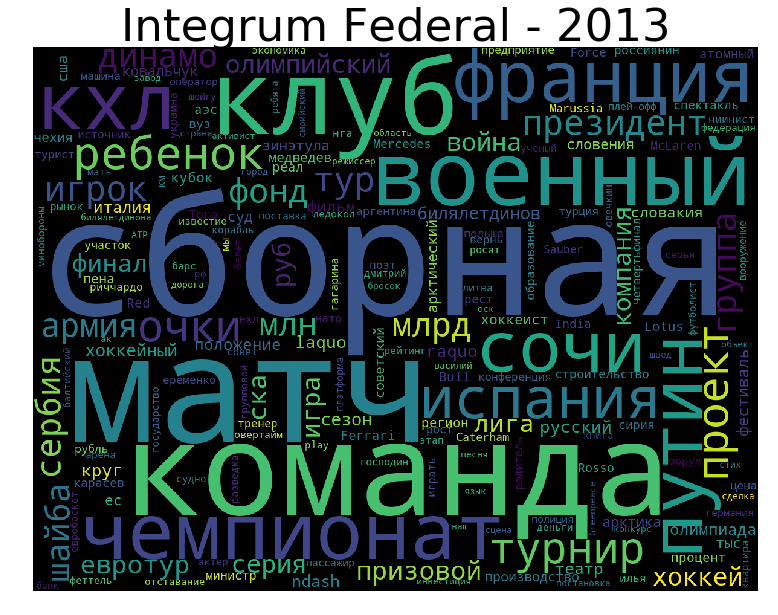

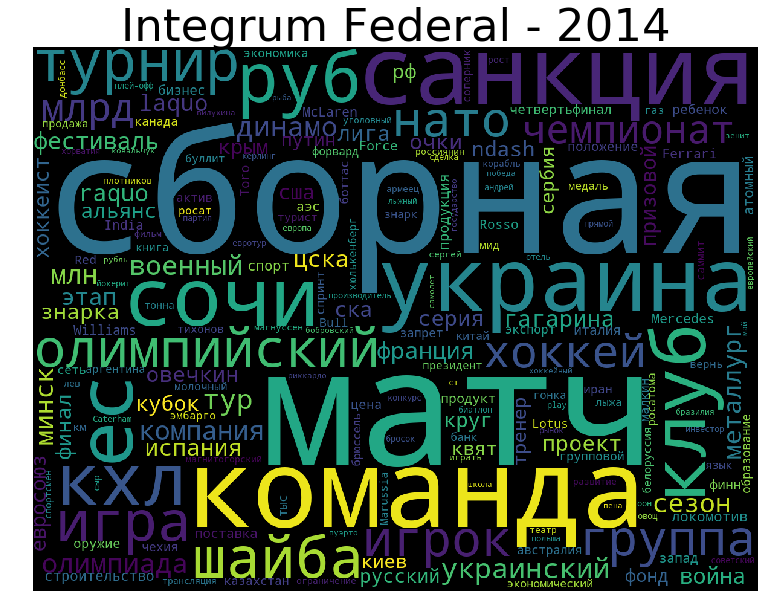

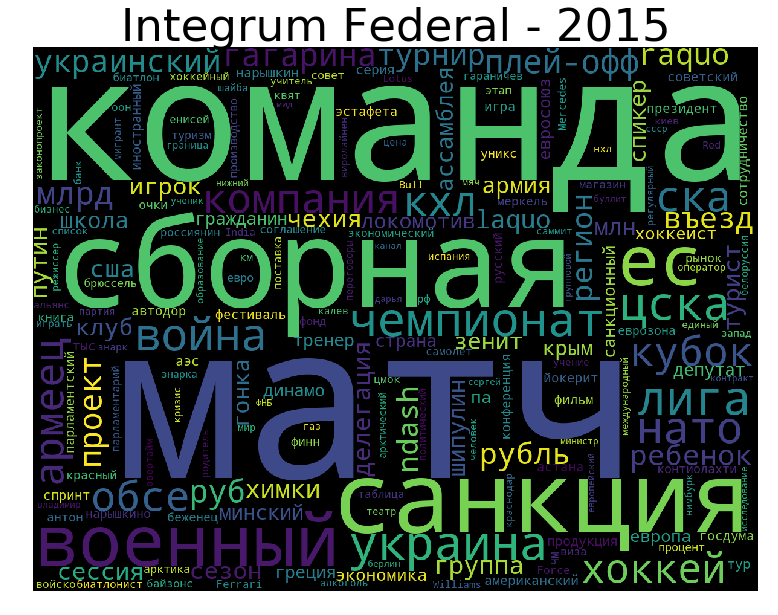

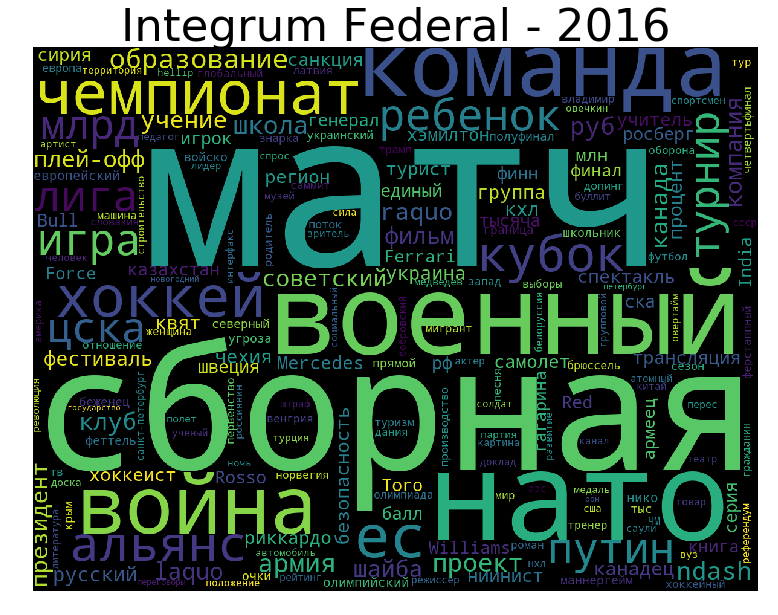

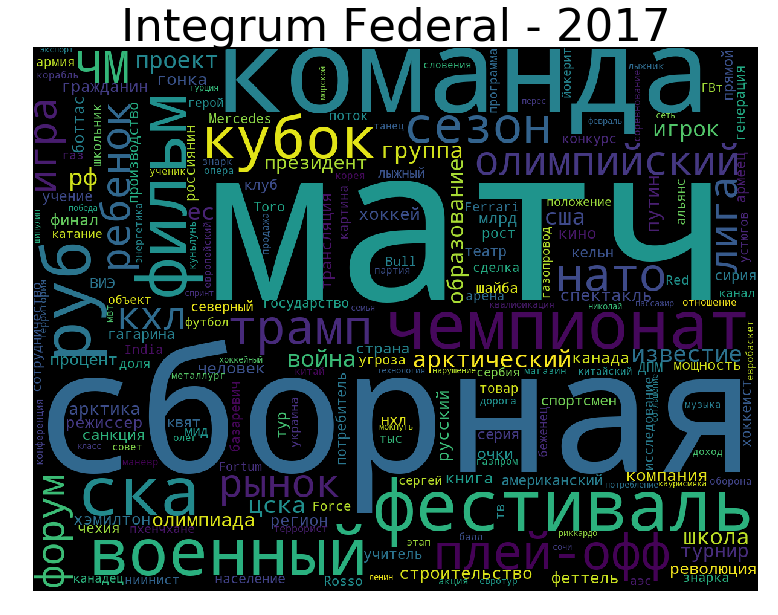

In [66]:
print_yearly_wordclouds(integrum_local_tfidf_words, prefix = "Integrum Local - ")
print_yearly_wordclouds(integrum_federal_tfidf_words, prefix = "Integrum Federal - ")

# Unique events per year integrum

In [8]:
federal_by_year = pd.Series(name = 'lemmas', index = sorted(integrum_federal_lemmas.year.unique()))
local_by_year = pd.Series(name = 'lemmas', index = sorted(integrum_local_lemmas.year.unique()))

#populate yearly data

def populate_yearly_data(output_series, data):
    for year in output_series.index:
        output_series[year] = list(data[data.year == year].lemmas_content.values)[0]


populate_yearly_data(federal_by_year, integrum_federal_lemmas)
populate_yearly_data(local_by_year, integrum_local_lemmas)

In [14]:
# Run tf-idf on yearly data
federal_tfidf_yearly, federal_dictionary_yearly = get_corpus_tfidf(federal_by_year)
top_words_federal_yearly = get_top_words(federal_tfidf_yearly, federal_dictionary_yearly)

local_tfidf_yearly, local_dictionary_yearly = get_corpus_tfidf(local_by_year)
top_words_local_yearly = get_top_words(local_tfidf_yearly, local_dictionary_yearly)


# drop rows where tfidf is nan
#yle_fi_tfidf_data = yle_fi_tfidf_data.drop(yle_fi_tfidf_data[yle_fi_tfidf_data.year.isnull()].index)

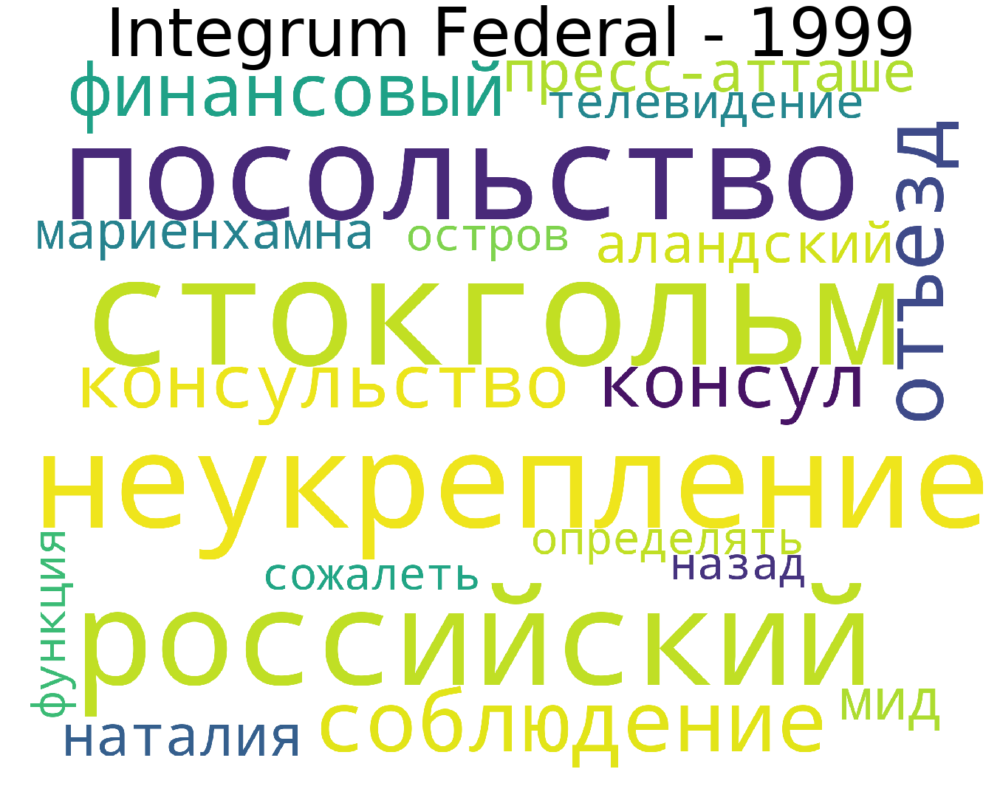

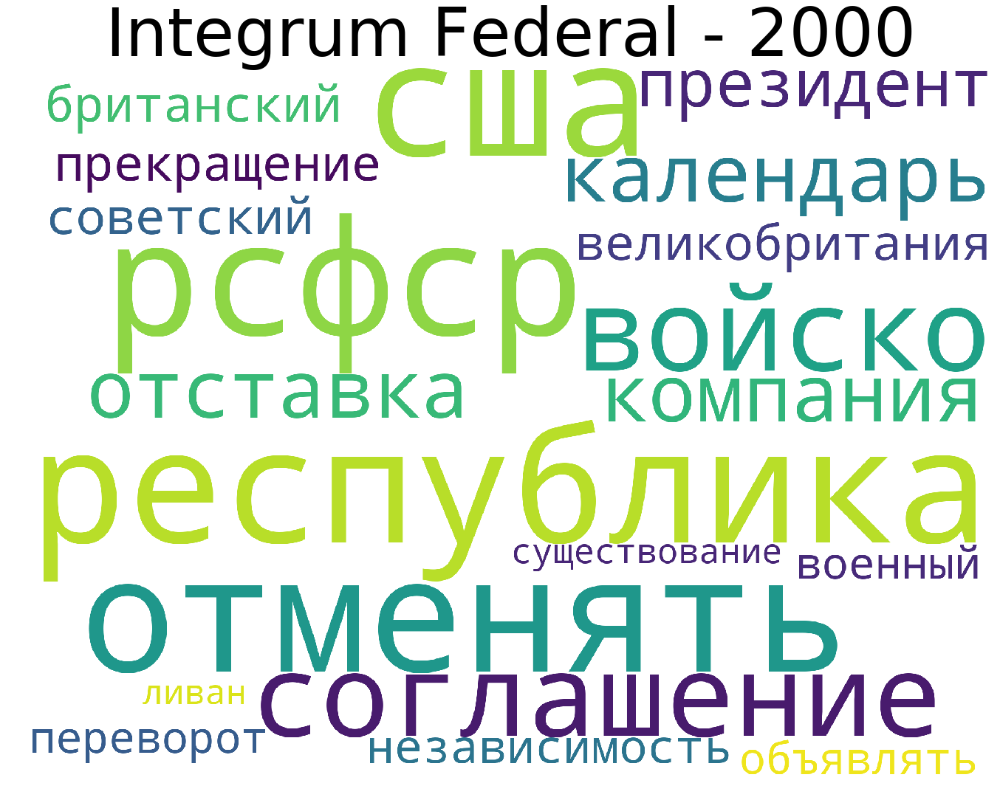

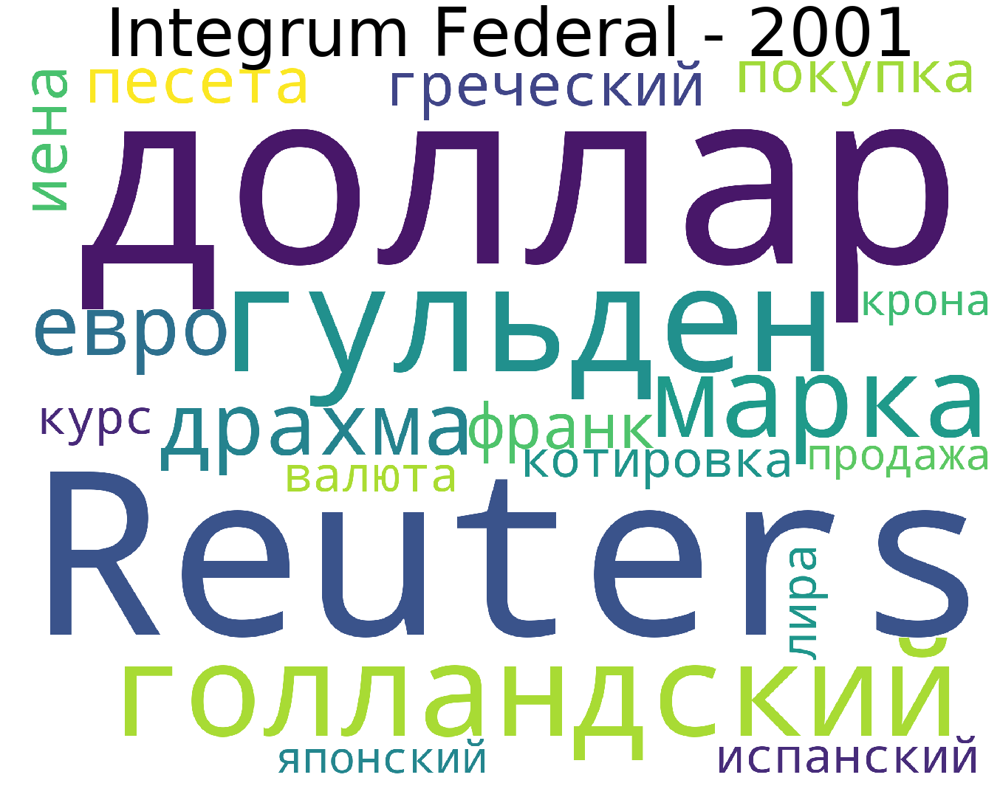

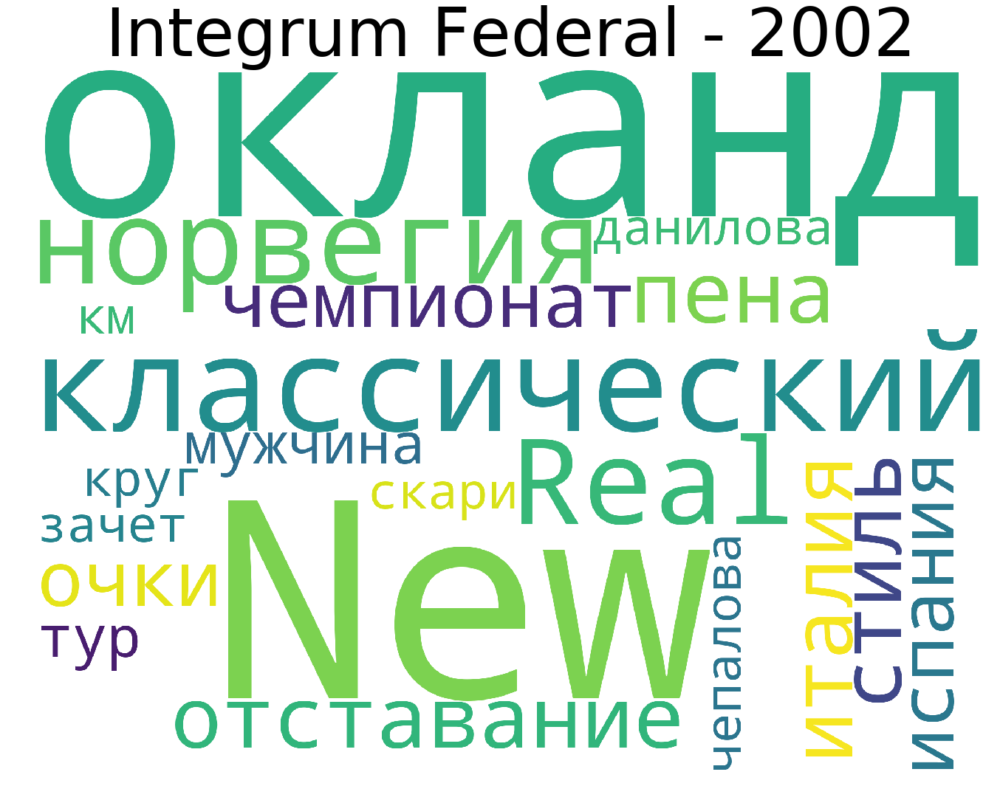

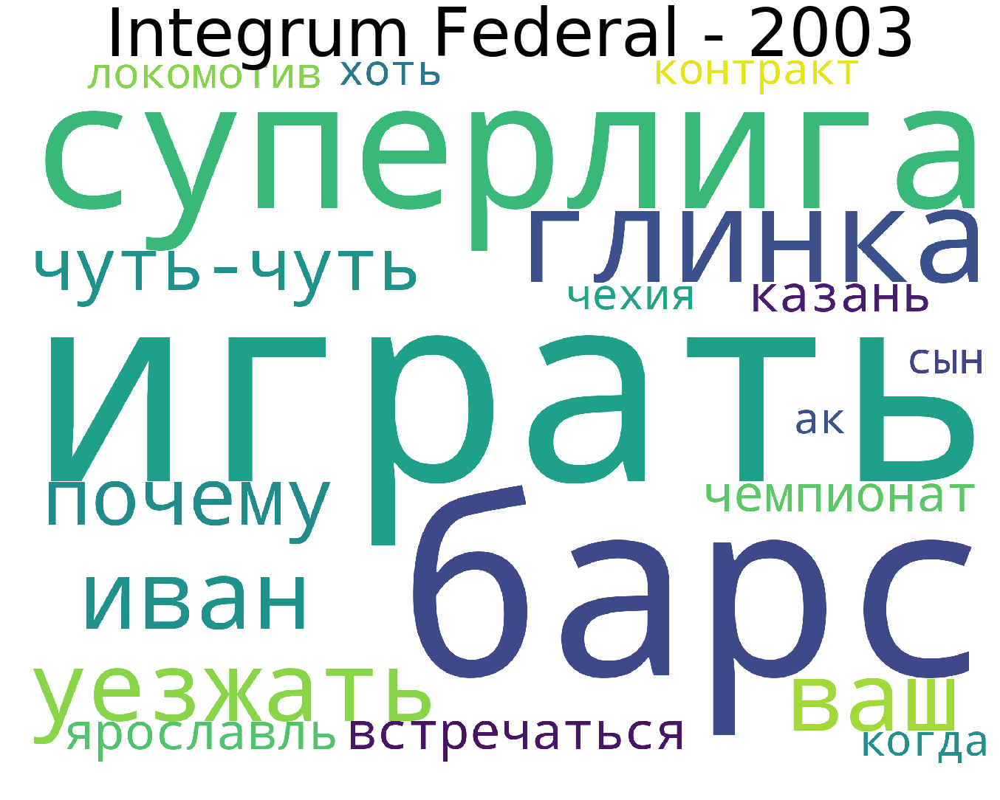

...

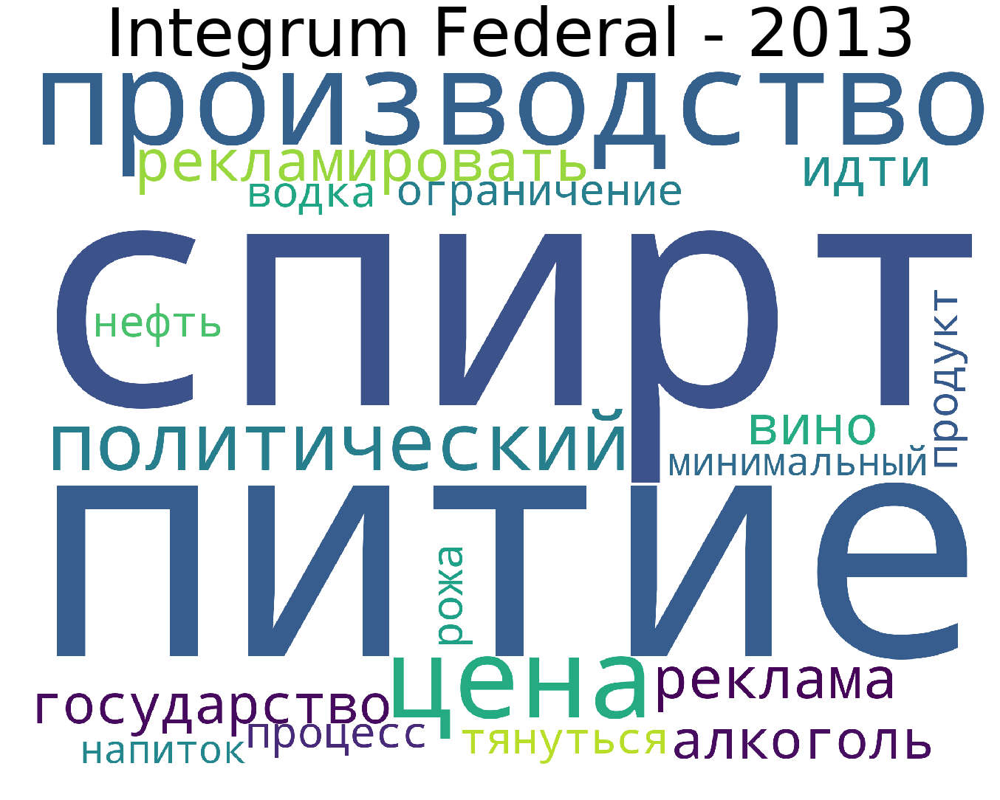

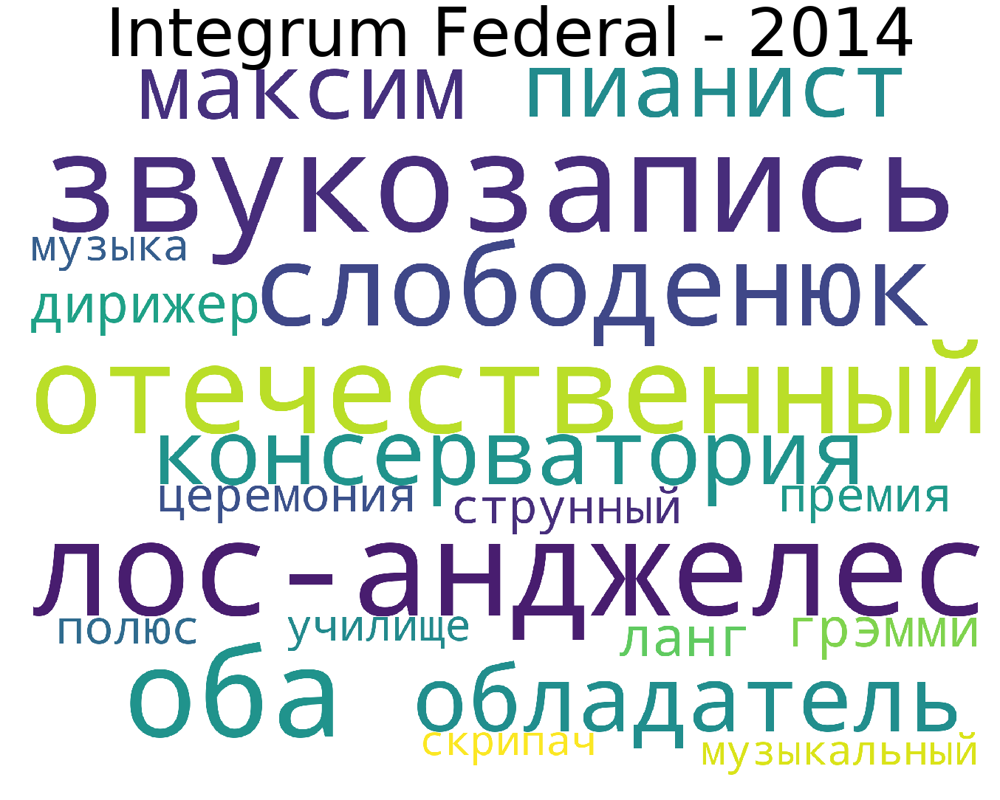

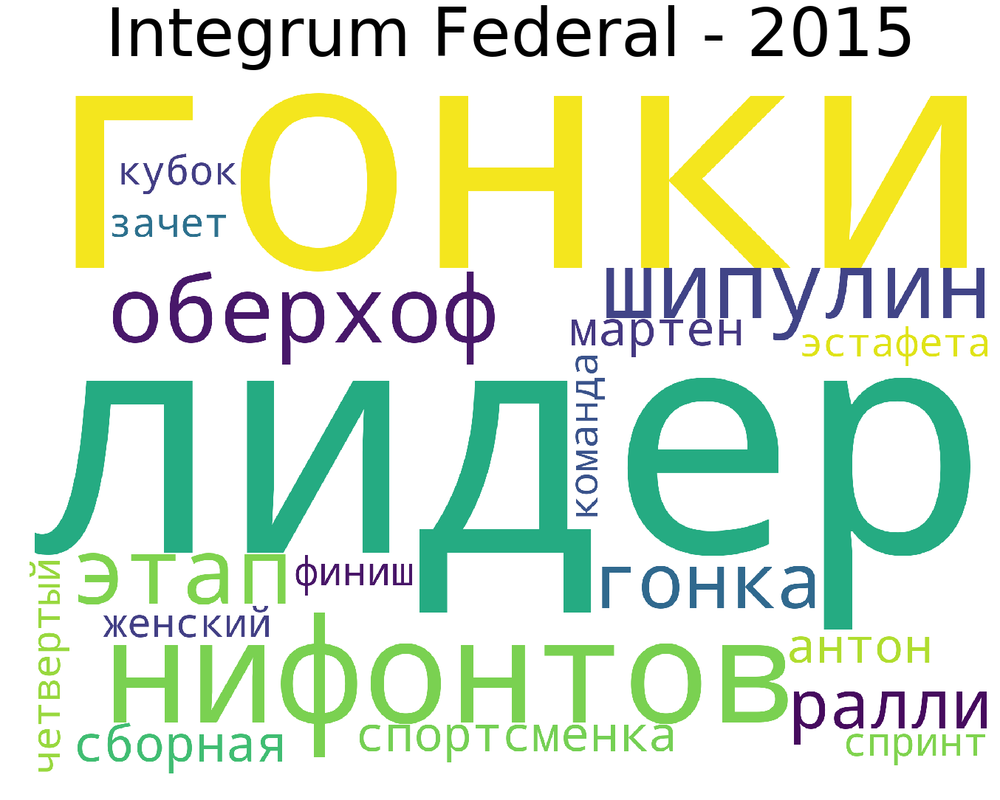

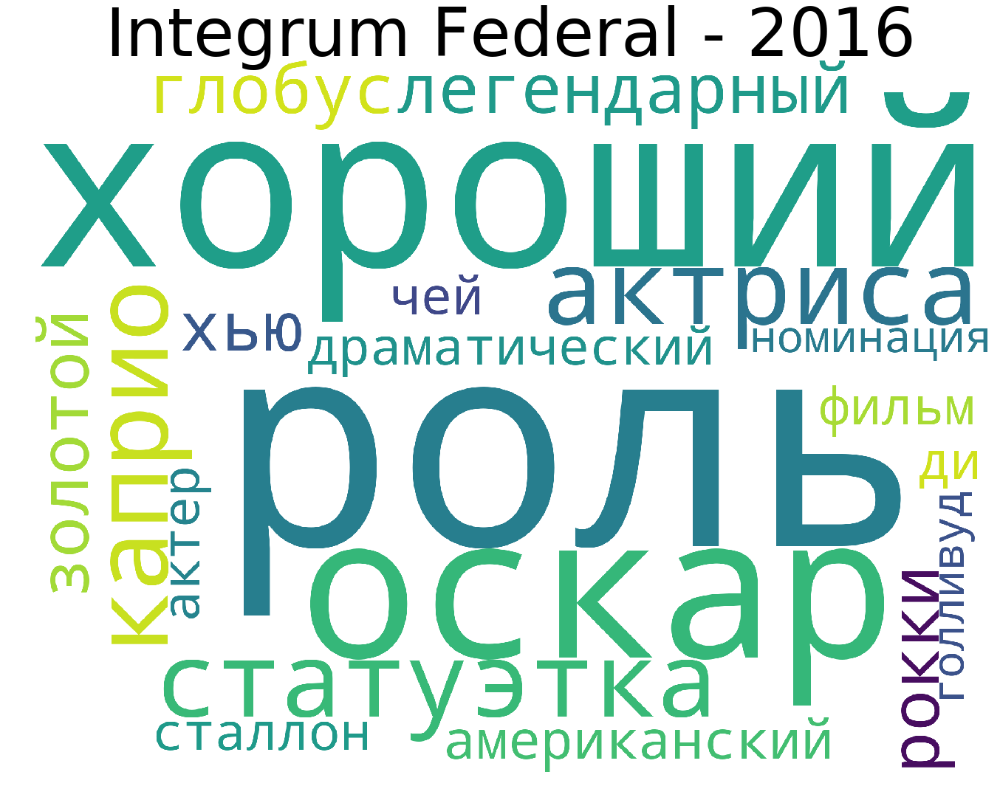

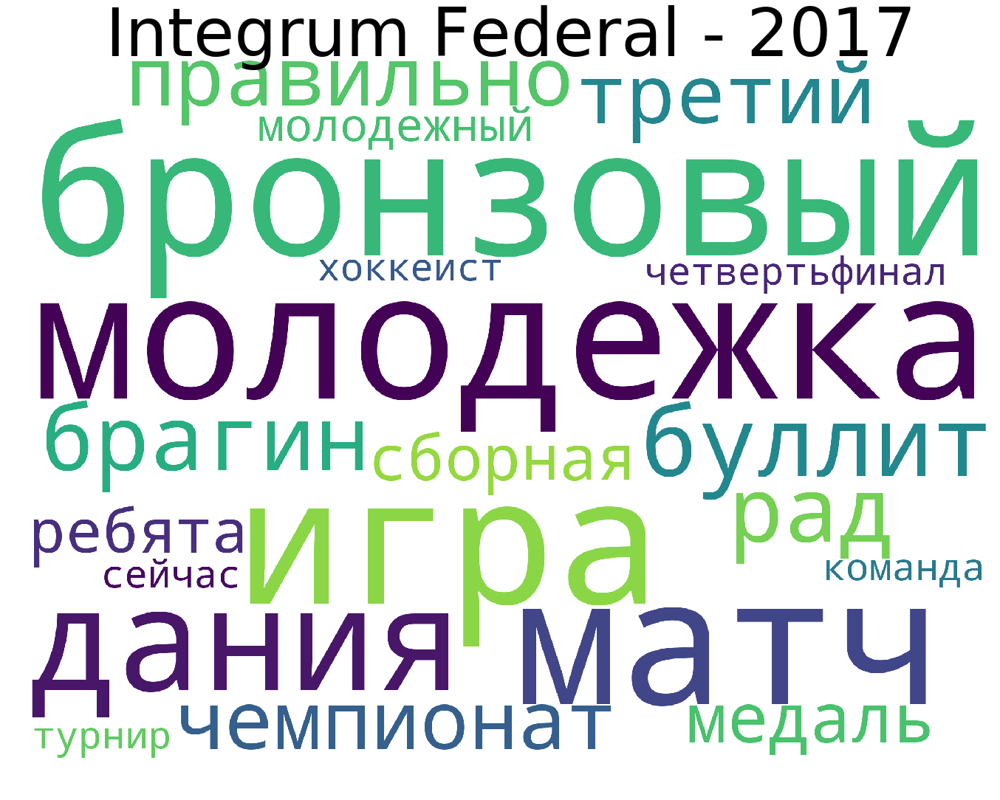

In [15]:
years = federal_by_year.index

for i, year in enumerate(years):
    prefix = "Integrum Federal - "
    counts = yearly_counts(top_words_federal_yearly[i])  
    title = prefix + str(year)
    output_wordcloud(counts, title,  True, 'generated_images_unique_yearly/')